In [1]:
import numpy as np
import pandas as pd
import sys 
sys.path.insert(0, '/home/toque/work/forecast/utils/')
import utils
import utils_date

import itertools
from multiprocessing import cpu_count
from joblib import Parallel
from joblib import delayed
from warnings import catch_warnings
from warnings import filterwarnings
from sklearn.metrics import mean_squared_error
from math import sqrt

import matplotlib.pyplot as plt

from statsmodels.tsa.statespace import sarimax

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.api import ExponentialSmoothing

import seaborn
seaborn.set_style('whitegrid')

from tqdm import tqdm
import ast
import os

In [2]:
def create_Xy_basic(start, end, obs, fea, index='Datetime'):
    """
            extract values from dataframe obs to y variable 
            and values of dataframe fea to X variable
    """
    
    date_list = utils_date.get_list_common_date(start, end, obs, [fea])
    
    y = obs.set_index(index).loc[date_list].values
    X = fea.set_index(index).loc[date_list].values
    mask = (X!=0).sum(axis=0)!=0
    
    X = X[:,mask]
    y_name_list = obs.set_index(index).columns.values
    X_name_list = fea.set_index(index).columns.values[mask]
    
    return y, X, y_name_list, X_name_list

# root mean squared error or rmse
def measure_rmse(obs, pred):
    return sqrt(mean_squared_error(obs, pred))

In [3]:
# grid search configs
def grid_search(Yendog_train, Yendog_val, exog_train, exog_val, cfg_list, n_jobs=False, parallel=True, ts_index=''):
    if n_jobs==False:
        n_jobs = cpu_count()
    scores = None
    if parallel:
        # execute configs in parallel
        executor = Parallel(n_jobs=n_jobs, backend='multiprocessing')
        tasks = (delayed(score_model)(Yendog_train, Yendog_val, exog_train, exog_val, cfg, debug=False) for cfg in tqdm(cfg_list,desc='Time series {}'.format(ts_index)))
        scores = executor(tasks)
    else:
        scores = [score_model(Yendog_train, Yendog_val, exog_train, exog_val, cfg) for cfg in tqdm(cfg_list, desc='Time series {}'.format(ts_index))]
    # remove empty results
    scores = [r for r in scores if r[1] != None]
    # sort configs by error, asc
    scores.sort(key=lambda tup: tup[1])
    return scores

# score a model, return None on failure
def score_model(Yendog_train, Yendog_val, exog_train, exog_val, cfg, debug=False):
    result = None
    key = str(cfg)
    # show all warnings and fail on exception if debugging
    if debug:
        result = fit_and_predict(Yendog_train, Yendog_val, exog_train, exog_val, cfg)
    else:
        # one failure during model validation suggests an unstable config
        try:
            # never show warnings when grid searching, too noisy
            with catch_warnings():
                filterwarnings("ignore")
                result = fit_and_predict(Yendog_train, Yendog_val, exog_train, exog_val, cfg)
        except:
            error = None
    # check for an interesting result
    #if result is not None:
        #print(' > Model[{}] {:.2f}'.format(key, result))
    return (key, result)

# fit_and_predict
def fit_and_predict(Yendog_train, Yendog_val, exog_train, exog_val, cfg):
    order, sorder, trend = cfg
    model = sarimax.SARIMAX(Yendog_train.flatten(), exog_train, order=order, seasonal_order=sorder, trend=trend,
                            enforce_stationarity=False, enforce_invertibility=False)
    model_fit = model.fit(disp=5)
    predictions = model_fit.predict(start=len(Yendog_train), end=len(Yendog_train)+len(Yendog_val)-1, exog=exog_val)
    #plt.plot(predictions, label ='pred')
    #plt.plot(Yendog_val.flatten(), label ='obs')
    #plt.legend()
    #plt.show()
    
    error = measure_rmse(Yendog_val.flatten(), predictions)

    return error


def sarima_configs(param_grid):

    configs = [[(i[0],i[1],i[2]), (i[3],i[4],i[5],i[6]), i[7]] for i in itertools.product(*[param_grid['p_params'],
                                                                                            param_grid['d_params'],
                                                                                            param_grid['q_params'],
                                                                                            param_grid['P_params'],
                                                                                            param_grid['D_params'],
                                                                                            param_grid['Q_params'],
                                                                                            param_grid['m_params'],
                                                                                            param_grid['t_params']])]
    return configs

# Data

In [4]:
obs_path = ['/home/toque/data2/montreal/stm/data/valid_metro_15min_2015_2016_2017_sumpass_nodayfree_aggdaily.csv']
fea_path = ['/home/toque/data2/date/2013-01-01-2019-01-01_new.csv',
            '/home/toque/data2/montreal/events/data/clean/events_2015_2018_start_event_stopid_aggdaily.csv',
            '/home/toque/data2/montreal/events/data/clean/events_2015_2018_end_event_stopid_aggdaily.csv',
            '/home/toque/data2/montreal/events/data/clean/events_2015_2018_period_event_stopid_aggdaily.csv',
           ]

obs = utils.read_csv_list(obs_path)
fea = utils.read_csv_list(fea_path)

In [5]:
features_others = ['2-end_event', '3-end_event', '4-end_event', '5-end_event',
                       '6-end_event', '8-end_event', '9-end_event', '10-end_event',
                       '11-end_event', '12-end_event', '13-end_event', '14-end_event',
                       '15-end_event', '16-end_event', '23-end_event', '24-end_event',
                       '30-end_event', '31-end_event', '32-end_event', '34-end_event',
                       '35-end_event', '40-end_event', '43-end_event', '45-end_event',
                       '47-end_event', '61-end_event', '68-end_event', '1-start_event',
                       '2-start_event', '3-start_event', '4-start_event', '5-start_event',
                       '6-start_event', '8-start_event', '9-start_event', '10-start_event',
                       '11-start_event', '12-start_event', '13-start_event',
                       '14-start_event', '15-start_event', '16-start_event',
                       '23-start_event', '24-start_event', '29-start_event',
                       '30-start_event', '31-start_event', '32-start_event',
                       '34-start_event', '35-start_event', '40-start_event',
                       '43-start_event', '45-start_event', '47-start_event',
                       '61-start_event', '68-start_event', '16-period_event',
                       '15-period_event', '13-period_event', '12-period_event',
                       '45-period_event', '24-period_event', '43-period_event',
                       '9-period_event', '31-period_event', '10-period_event',
                       '47-period_event', '8-period_event', '11-period_event',
                       '30-period_event', '4-period_event', '61-period_event',
                       '14-period_event', '68-period_event', '23-period_event',
                       '5-period_event', '6-period_event', '34-period_event',
                       '32-period_event', '40-period_event', '35-period_event',
                       '3-period_event', '2-period_event']

features_todummy = ['Day_en', 'Mois']

features_nottodummy = ['24DEC', '31DEC', 'day_off_quebec', 'renov_beaubien', 
                       'vac_udem1', 'vac_udem2', 'vac_noel_quebec', 'Year',]

time_series = ['11', '32', '34', '15', '44', '65', '31', '33', '35', '47', '13',
       '14', '1', '9', '5', '18', '36', '24', '68', '43', '8', '64', '10',
       '55', '3', '49', '51', '2', '19', '56', '7', '6', '4', '48', '66',
       '25', '23', '28', '39', '54', '60', '27', '20', '46', '12', '21',
       '62', '52', '41', '50', '30', '16', '37', '40', '26', '67', '57',
       '61', '42', '45', '38', '29', '58', '63', '22', '59', '53', '17']

fea = utils.df_todummy_df(fea, features_todummy, features_nottodummy)
obs = obs.set_index('Datetime')[time_series].reset_index()

# SARIMAX - Optimisation

In [9]:
model_name = 'sarimax_stm_aggday'
path_model_optimization = '/home/toque/data2/forecast/model/sarimax/optimize/'
force_save = True

param_grid = {'p_params': [0, 1, 7, 10, 14],
              'd_params': [0],
              'q_params': [0, 1, 2],
              'P_params': [0, 7],
              'D_params': [0, 1],
              'Q_params': [0, 2], 
              'm_params': [0, 1, 7, 14], 
              't_params': ['c','ct']}

param_grid = {'p_params': [0, 7],
              'd_params': [0],
              'q_params': [0],
              'P_params': [0],
              'D_params': [0],
              'Q_params': [0], 
              'm_params': [7], 
              't_params': ['c']}

model_infos = {}
model_infos['name'] = model_name
model_infos['path_model_optimization'] = path_model_optimization
model_infos['time_series'] = time_series
model_infos['features'] = fea.set_index('Datetime').columns.values
model_infos['obs_path'] = obs_path
model_infos['fea_path'] = fea_path
model_infos['param_grid'] = param_grid

In [10]:
# Data split (Train-Validation)
start_train_list, end_train_list, end_val_list = ['2015-01-01', '2015-01-01', '2015-01-01', '2015-01-01'], ['2016-01-01', '2016-04-01', '2016-07-01', '2016-10-01'], ['2016-04-01', '2016-07-01', '2016-10-01', '2017-01-01']
model_infos['start_train_list'] = start_train_list
model_infos['end_train_list'] = end_train_list
model_infos['end_val_list'] = end_val_list

# Configs 
configs = sarima_configs(param_grid)

grid_search_params = {}

for start_train, end_train, end_val in zip(start_train_list, end_train_list, end_val_list):
    Yendog, exog, Yendog_name_list, exog_name_list = create_Xy_basic(start_train, end_val, obs, fea)
    
    index_train = len(utils_date.get_list_common_date(start_train, end_train, obs, [fea]))
    Yendog_train = Yendog[:index_train]
    #mean_ = Yendog_train.mean()
    #std_ = Yendog_train.std()
    
    #Yendog_train =(Yendog[:index_train]-mean_)/std_
    Yendog_val = Yendog[index_train:]
    
    exog_train, exog_val = exog[:index_train], exog[index_train:]

    
    for ts_index, ts in enumerate(time_series):
        
        scores = grid_search(Yendog_train[:, ts_index], Yendog_val[:, ts_index],
                             exog_train, exog_val, configs, parallel = True, ts_index=ts_index)
        for c,s in scores:
            try:
                grid_search_params[ts]
            except:
                grid_search_params[ts]={}
            try:
                grid_search_params[ts][c].append(s)
            except:
                grid_search_params[ts][c]=[]
                grid_search_params[ts][c].append(s)


    
path_grid_search = path_model_optimization+model_name+'/grid_search.pkl'
path_model_infos = path_model_optimization+model_name+'/model_infos.pkl'
model_infos['path_grid_search'] = path_grid_search
model_infos['path_model_infos'] = path_model_infos

utils.save_pickle_safe(path_grid_search, grid_search_params, force_save = force_save)
utils.save_pickle_safe(path_model_infos, model_infos, force_save = force_save)  


Time series 59: 100%|██████████| 2/2 [00:00<00:00, 32.41it/s]


Time series 67: 100%|██████████| 2/2 [00:00<00:00, 31.38it/s]


AttributeError: module 'utils' has no attribute 'save_picke_safe'

# SARIMAX - Fit and predict

In [29]:
path_model_predict = '/home/toque/data2/forecast/model/sarimax/predict/'
path_model_infos = '/home/toque/data2/forecast/model/sarimax/optimize/sarimax_stm_aggday/model_infos.pkl'
model_infos = utils.load_pickle(path_model_infos)
model_infos['path_model_predict'] = path_model_predict

path_grid_search = model_infos['path_grid_search']
grid_search_params = utils.load_pickle(path_grid_search)


In [30]:
grid_search_params

{}

In [18]:
path_model_predict = '/home/toque/data2/forecast/model/sarimax/predict/'
path_model_infos = '/home/toque/data2/forecast/model/sarimax/optimize/sarimax_stm_aggday/model_infos.pkl'
model_infos = utils.load_pickle(path_model_infos)
model_infos['path_model_predict'] = path_model_predict

path_grid_search = model_infos['path_grid_search']
grid_search_params = utils.load_pickle(path_grid_search)



start_train = '2015-01-01'
end_train = '2017-01-01'
end_test = '2018-01-01'

configs = sarima_configs(model_infos['param_grid'])
best_params = {}

for ts in obs.set_index('Datetime').columns.values:
    res = [(str(cfg), np.array(grid_search_params[ts][str(cfg)]).mean()) for cfg in configs] 
    res.sort(key=lambda tup: tup[1])
    best_params[ts] = ast.literal_eval(res[0][0])

In [17]:
# Fit and predict 
Yendog, exog, Yendog_name_list, exog_name_list = create_Xy_basic(start_train, end_test, obs, fea)

index_train = len(utils_date.get_list_common_date(start_train, end_train, obs, [fea]))
Yendog_train, Yendog_test = Yendog[:index_train], Yendog[index_train:]
exog_train, exog_test = exog[:index_train], exog[index_train:]

predictions = []
for idx,ts in enumerate(tqdm(time_series, desc='Predict (Time series loop)')):
    order, sorder, trend = best_params[ts]
    model = sarimax.SARIMAX(Yendog_train[:,idx].flatten(), exog_train, order=order, seasonal_order=sorder, trend=trend,
                                enforce_stationarity=False, enforce_invertibility=False)
    model_fit = model.fit(disp=5)
    predictions.append(model_fit.predict(start=len(Yendog_train), end=len(Yendog_train)+len(Yendog_test)-1, exog=exog_test))
    
predictions = np.array(predictions).T    
predictions[predictions<0]=0
    

Predict (Time series loop): 100%|██████████| 68/68 [00:15<00:00,  4.27it/s]


In [22]:
#Save the prediction
df = obs.set_index('Datetime').loc[end_train:end_test].reset_index().copy()
for idx,ts in enumerate(time_series):
    df[ts] = predictions[:,idx]
try:
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_infos['name'], end_train, end_test))
except FileNotFoundError:
    os.makedirs('{}{}/'.format(path_model_predict, model_infos['name']))
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_infos['name'], end_train, end_test))
    

In [23]:
#utils.rmse(obs.set_index('Datetime').loc[end_train:end_test].values.flatten(),df.set_index('Datetime').values.flatten()) 

1659.457278857928

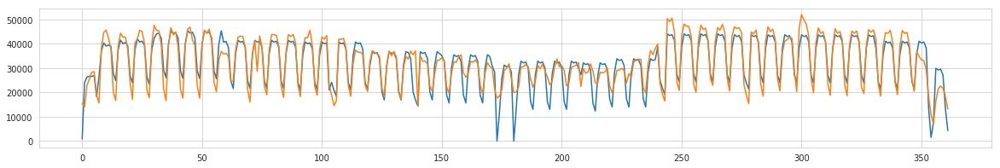

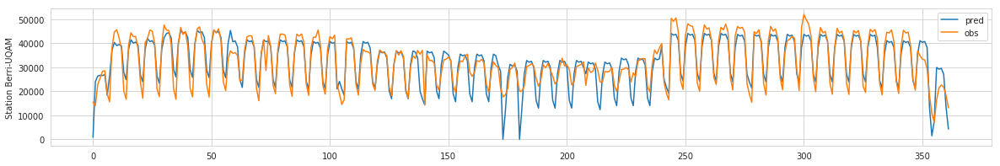

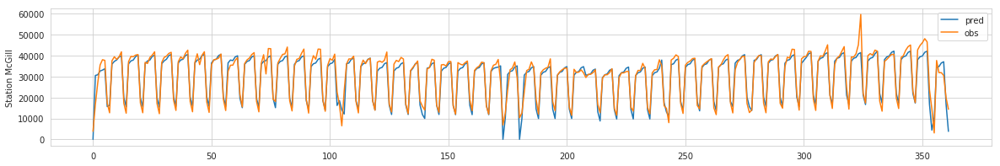

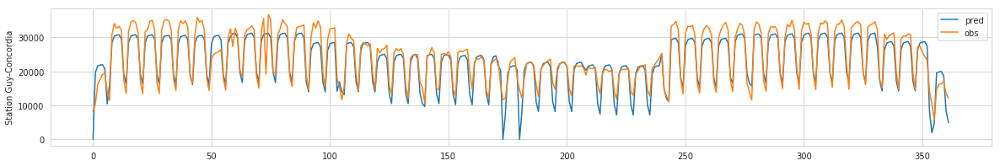

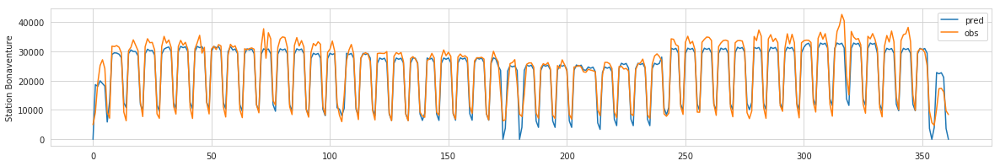

...

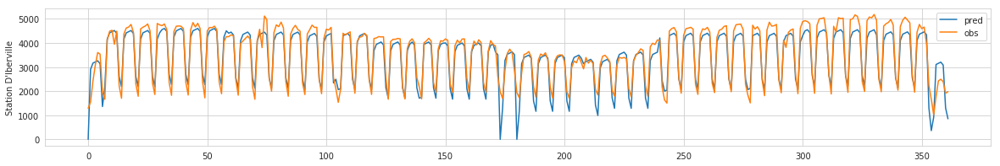

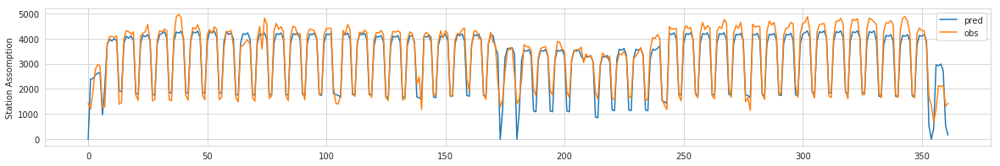

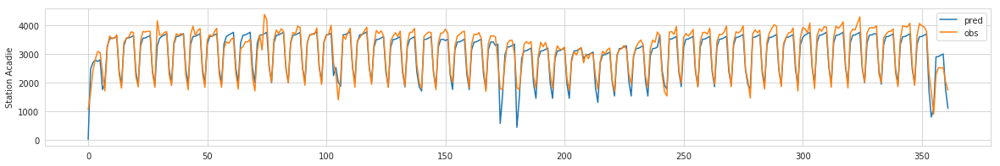

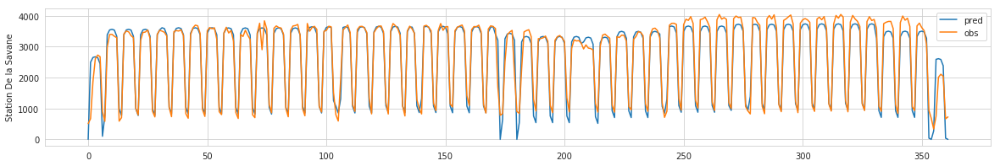

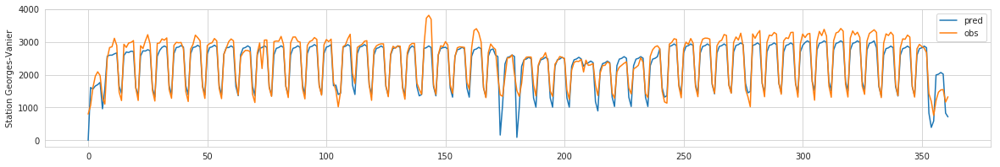

In [28]:
dict_id_name = dict(pd.read_csv('/home/toque/data2/montreal/stm/data/station_info.csv')[['stop_id', 'stop_name']].values.astype(str))
time_series_name = [dict_id_name[i] for i in time_series]
for idx,ts in enumerate(obs.set_index('Datetime').columns.values):
    fig,ax = plt.subplots(figsize=(20,3))
    plt.plot(predictions[:,idx], label='pred')
    plt.plot(Yendog_test[:,idx], label='obs')
    plt.ylabel(time_series_name[idx])
    plt.legend()
    plt.show()
    

# Linear regression

In [136]:
from sklearn import linear_model

model_name = 'linear_regression_stm_aggday'
path_model_optimization = '/home/toque/data2/forecast/model/linear_regression/optimize/'
path_model_predict = '/home/toque/data2/forecast/model/linear_regression/predict/'

start_train = '2015-01-01'
end_train = '2017-01-01'
end_test = '2018-01-01'

Yendog, exog, Yendog_name_list, exog_name_list = create_Yendog_exog(start_train, end_test, obs, fea)
index_train = len(utils_date.get_list_common_date(start_train, end_train, obs, [fea]))
Yendog_train, Yendog_test = Yendog[:index_train], Yendog[index_train:]
exog_train, exog_test = exog[:index_train], exog[index_train:]

predictions = []
for idx,ts in enumerate(tqdm(time_series)):
    reg = linear_model.LinearRegression()
    reg = reg.fit(exog_train,Yendog_train[:,idx])
    predictions.append(reg.predict(exog))

predictions = np.array(predictions).T
predictions[predictions<0] = 0
df = obs.copy()
for idx,ts in enumerate(time_series):
    df[ts] = predictions[:,idx]
try:
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_name, end_train, end_test))
except FileNotFoundError:
    os.makedirs('{}{}/'.format(path_model_predict, model_name))
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_name, end_train, end_test))

100%|██████████| 68/68 [00:00<00:00, 1845.93it/s]


In [124]:
#utils.rmse(obs.set_index('Datetime').loc[end_train:end_test].values.flatten(),df.set_index('Datetime').loc[end_train:end_test].values.flatten()) 

1657.1082402405041

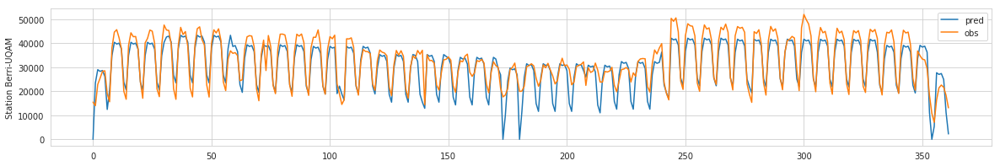

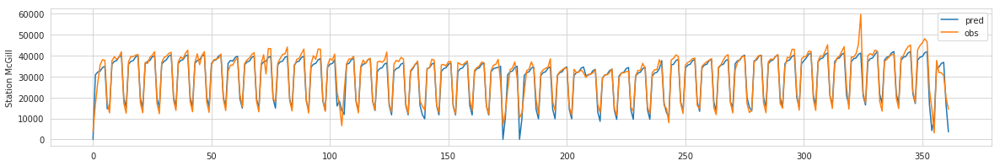

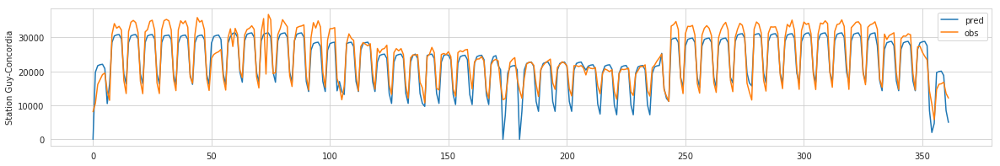

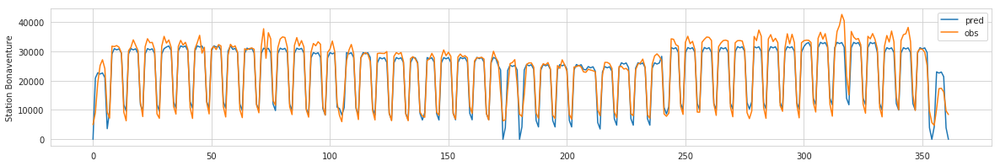

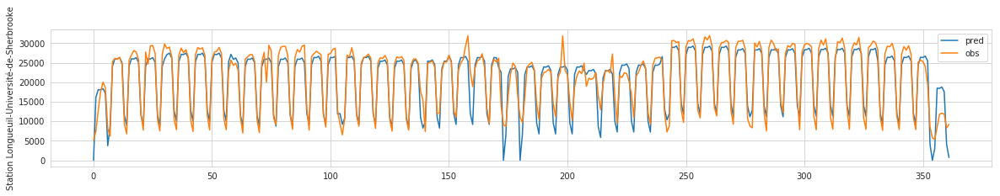

...

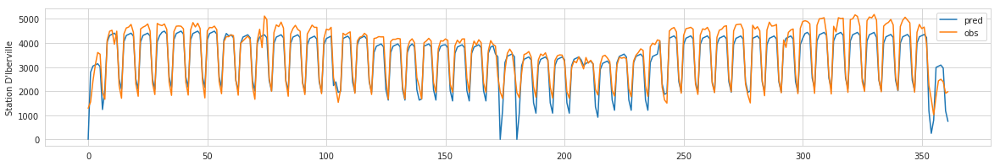

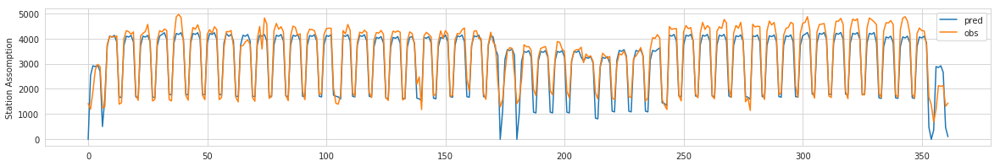

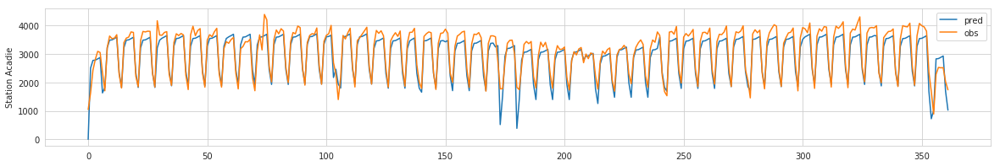

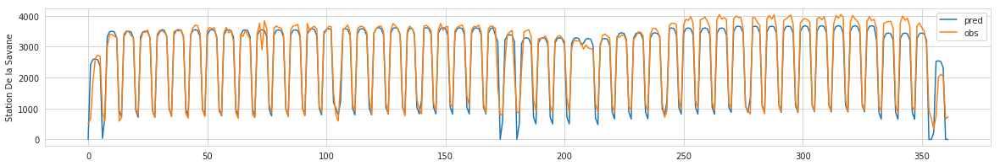

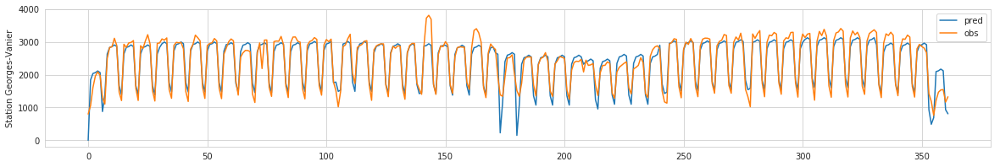

In [138]:
for idx,ts in enumerate(obs.set_index('Datetime').columns.values):
    fig,ax = plt.subplots(figsize=(20,3))
    plt.plot(predictions[index_train:,idx], label='pred')
    plt.plot(Yendog[index_train:,idx], label='obs')
    plt.ylabel(name_list[idx])
    plt.legend()
    plt.show()

# Random Forest

In [209]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold

model_name = 'random_forest_stm_aggday'
path_model_optimization = '/home/toque/data2/forecast/model/random_forest_aggdata/optimize/'
path_model_predict = '/home/toque/data2/forecast/model/random_forest_aggdata/predict/'
force_save = True

start_train = '2015-01-01'
end_train = '2017-01-01'
end_test = '2018-01-01'

Yendog, exog, Yendog_name_list, exog_name_list = create_Yendog_exog(start_train, end_test, obs, fea)
index_train = len(utils_date.get_list_common_date(start_train, end_train, obs, [fea]))
Yendog_train, Yendog_test = Yendog[:index_train], Yendog[index_train:]
exog_train, exog_test = exog[:index_train], exog[index_train:]


# Optimize

In [205]:
param_kfold={
    'n_splits': 5,
    'shuffle': True,
    'random_state': 1}

param_grid={
    'n_estimators': [100, 150, 200],
    'max_features': ['auto',None],
    'max_depth': [None],
    'min_samples_split': [2,5,10],
    'min_samples_leaf': [1,5,10],
    'n_jobs': [6],
    'criterion': ['mse']}
scoring = "neg_mean_squared_error"

param_kfold={
    'n_splits': 2,
    'shuffle': True,
    'random_state': 1}

param_grid={
    'n_estimators': [100],
    'max_features': ['auto'],
    'max_depth': [None],
    'min_samples_split': [2],
    'min_samples_leaf': [1],
    'n_jobs': [6],
    'criterion': ['mse']}

grid_search_dict = {}
for idx,ts in enumerate(tqdm(time_series)):
    rf = RandomForestRegressor()

    cv = KFold(**param_kfold)
    grid_search = GridSearchCV(rf, param_grid=param_grid, n_jobs=1, cv=cv, verbose=0, scoring=scoring)
    grid_search.fit(exog_train, Yendog_train[:,idx])

    # Save space disk
    grid_search.estimator = None
    grid_search.best_estimator_ = None
    grid_search_dict[ts] = grid_search

    
if force_save:
    utils.save_pickle(path_model_optimization+model_name+'/grid_search.pkl', results)
elif  os.path.isfile(path_model_optimization+model_name+'/grid_search.pkl'):
    if utils.yes_or_no("The file {} already exist. Do you want to erase it?"):
        utils.save_pickle(path_model_optimization+model_name+'/grid_search.pkl', results)
else:
    utils.save_pickle(path_model_optimization+model_name+'/grid_search.pkl', results)


100%|██████████| 68/68 [01:09<00:00,  1.02s/it]


In [206]:
predictions = []
for idx,ts in enumerate(tqdm(time_series)):
    best_params = grid_search_dict[ts].best_params_
    rf = RandomForestRegressor(**best_params)
    rf = rf.fit(exog_train,Yendog_train[:,idx])
    predictions.append(rf.predict(exog))


100%|██████████| 68/68 [00:21<00:00,  3.22it/s]


In [207]:
predictions = np.array(predictions).T
predictions[predictions<0] = 0
df = obs.copy()
for idx,ts in enumerate(time_series):
    df[ts] = predictions[:,idx]
try:
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_name, end_train, end_test))
except FileNotFoundError:
    os.makedirs('{}{}/'.format(path_model_predict, model_name))
    df.to_csv('{}{}/{}_{}.csv'.format(path_model_predict, model_name, end_train, end_test))

In [208]:
#1291.1282035853974 with event data
#1318.5396141978413 without event data

utils.rmse(obs.set_index('Datetime').loc[end_train:end_test].values.flatten(),df.set_index('Datetime').loc[end_train:end_test].values.flatten()) 

1318.5396141978413

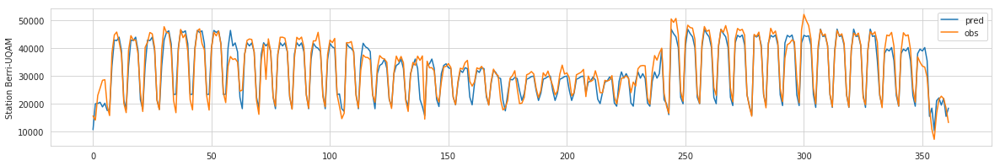

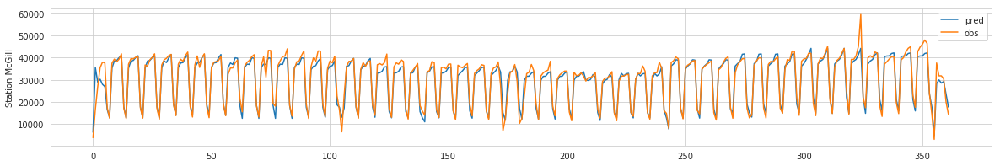

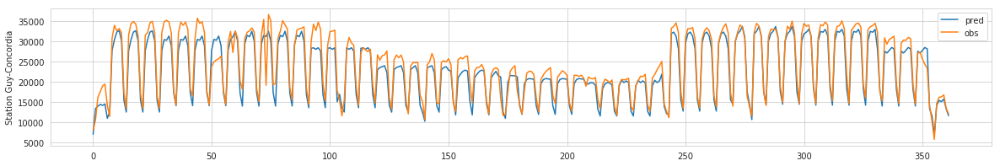

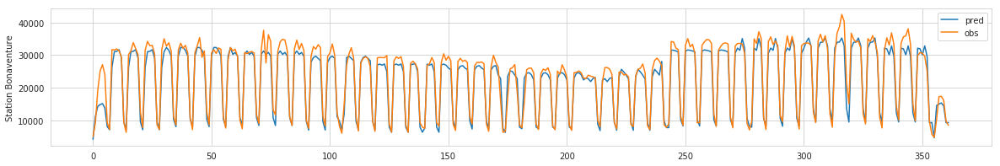

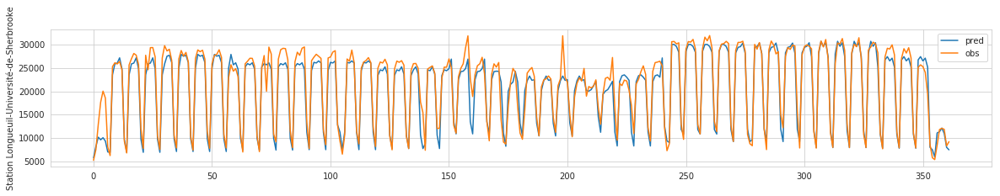

...

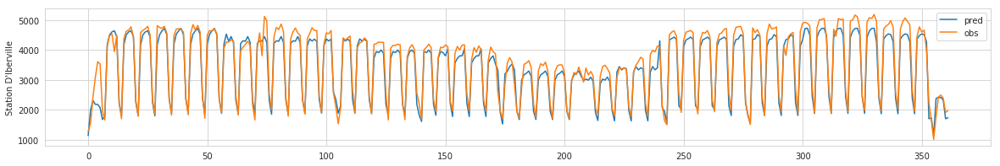

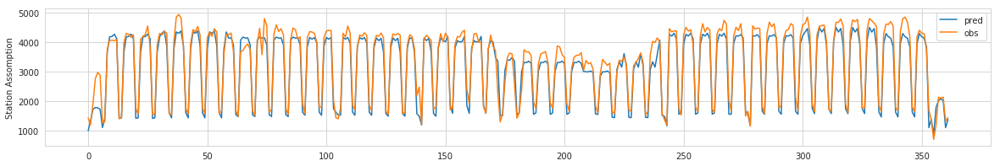

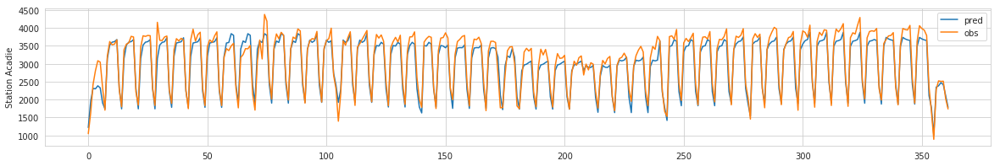

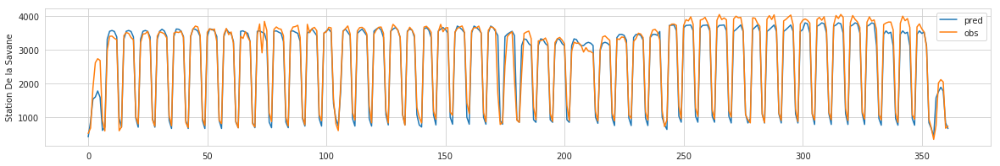

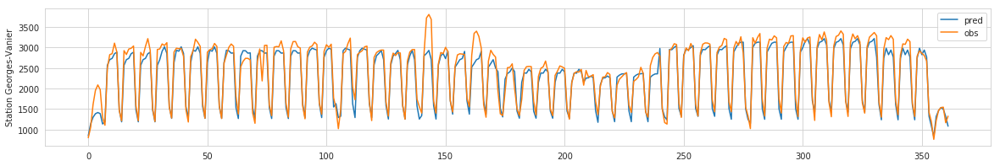

In [167]:
for idx,ts in enumerate(obs.set_index('Datetime').columns.values):
    fig,ax = plt.subplots(figsize=(20,3))
    plt.plot(predictions[index_train:,idx], label='pred')
    plt.plot(Yendog[index_train:,idx], label='obs')
    plt.ylabel(name_list[idx])
    plt.legend()
    plt.show()